In [14]:
import glob
import os
import librosa.display
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.pyplot import specgram
%matplotlib inline
plt.style.use('ggplot')
mpl.rcParams['agg.path.chunksize'] = 10000

# Plot specgrams

In [15]:
def iter_label_files(parent_dir):
    for root, dirpaths, fnames in os.walk(parent_dir):
        if len(dirpaths) > 0:
            continue
        label = root.split('/')[-1]
        yield root, label, fnames

def load_sound_files(parent_dir, file_paths):
    raw_sounds = []
    for fp in file_paths:
        X,sr = librosa.load(os.path.join(parent_dir, fp))
        raw_sounds.append(X)
    return raw_sounds

def plot_waves(sound_names,raw_sounds):
    i = 1
    fig = plt.figure(figsize=(25,10), dpi = 900)
    for n,f in zip(sound_names,raw_sounds):
        plt.subplot(2,5,i)
        librosa.display.waveplot(np.array(f),sr=22050)
        plt.title(n.title())
        i += 1
    plt.suptitle('Figure 1: Waveplot',x=0.5, y=0.95,fontsize=18)
    plt.show()
    
def plot_specgram(sound_names,raw_sounds):
    i = 1
    fig = plt.figure(figsize=(25,10), dpi = 900)
    for n,f in zip(sound_names,raw_sounds):
        plt.subplot(2,5,i)
        specgram(np.array(f), Fs=22050)
        plt.title(n.title())
        i += 1
    plt.suptitle('Figure 2: Spectrogram',x=0.5, y=0.95,fontsize=18)
    plt.show()

def plot_log_power_specgram(sound_names,raw_sounds):
    i = 1
    fig = plt.figure(figsize=(25,10), dpi = 900)
    for n,f in zip(sound_names,raw_sounds):
        plt.subplot(2,5,i)
        D = librosa.logamplitude(np.abs(librosa.stft(f))**2, ref_power=np.max)
        librosa.display.specshow(D,x_axis='time' ,y_axis='log')
        plt.title(n.title())
        i += 1
    plt.suptitle('Figure 3: Log power spectrogram',x=0.5, y=0.95,fontsize=18)
    plt.show()

# Process labels

In [16]:
from sklearn import preprocessing

parent_dir = 'data/speech-accent-archive/recordings/'
labels = []
for _, label, _ in iter_label_files(parent_dir):
    labels.append(label)
print(f'{len(labels)} labels found, 1st 5: {labels[:5]}')

le = preprocessing.LabelEncoder()
le.fit(labels)
le.transform(['albania', 'afghanistan'])

176 labels found, 1st 5: ['afghanistan', 'albania', 'algeria', 'andorra', 'angola']


array([1, 0])

# Plot some charts

In [18]:
def plot_sample_sounds(num_samples=5):
    _, label, fnames = next(iter_label_files(parent_dir))
    sound_file_paths = fnames[:num_samples]
    sound_names = [f'{label}-{fnames[i]}' for i in range(num_samples)]
    raw_sounds = load_sound_files(root, sound_file_paths)
    plot_waves(sound_names, raw_sounds)
    plot_specgram(sound_names, raw_sounds)
    plot_log_power_specgram(sound_names, raw_sounds)
    
plot_sample_sounds()

# Extract some features
- concatenation of `[mfccs, mfcc_ds, mfcc_d_ds, chroma, mel, contrast, tonnetz]`

In [6]:
def extract_feature(file_name):
    X, sample_rate = librosa.load(file_name)
    print(f"Features : {len(X)}, sampled at {sample_rate} hz")
    stft = np.abs(librosa.stft(X))
    mfcc = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=40)  # e.g. mfcc.shape = (40, 1002) 
    mfccs = np.mean(mfcc.T,axis=0)  # take mean along each mfcc col:mfccs.shape = 40,
    mfcc_ds = np.mean(librosa.feature.delta(mfcc.T, axis=0))     # 1st order derivative
    mfcc_d_ds = np.mean(librosa.feature.delta(mfcc.T, order=2))  # 2nd order derivative
    chroma = np.mean(librosa.feature.chroma_stft(S=stft, sr=sample_rate).T,axis=0)
    mel = np.mean(librosa.feature.melspectrogram(X, sr=sample_rate).T,axis=0)
    contrast = np.mean(librosa.feature.spectral_contrast(S=stft, sr=sample_rate).T,axis=0)
    tonnetz = np.mean(librosa.feature.tonnetz(y=librosa.effects.harmonic(X), sr=sample_rate).T,axis=0)
    return mfccs,mfcc_ds,mfcc_d_ds,chroma,mel,contrast,tonnetz


In [19]:
_, label, fnames = next(iter_label_files(parent_dir))
sample_filename = os.path.join(parent_dir, label, fnames[1])
mfccs, mfcc_ds, mfcc_d_ds, chroma, mel, contrast, tonnetz = extract_feature(sample_filename)
all_features = np.hstack([mfccs, mfcc_ds, mfcc_d_ds, chroma, mel, contrast, tonnetz])
print("MFCCS  = ", len(mfccs))
print("MFCCDS  = ", mfcc_ds)
print("MFCCDDS  = ", mfcc_d_ds)
print("Chroma = ", len(chroma))
print("Mel = ", len(mel))
print("Contrast = ", len(contrast))
print("Tonnetz = ", len(tonnetz))

data_points, _ = librosa.load(sample_filename)
print("IN: Initial Data Points ={}, {}".format(len(data_points), np.shape(data_points)))
print("OUT: Total features =", len(all_features))

Features : 918554, sampled at 22050 hz
MFCCS  =  40
MFCCDS  =  -0.00026157398969
MFCCDDS  =  -0.061366921777
Chroma =  12
Mel =  128
Contrast =  7
Tonnetz =  6
IN: Initial Data Points =918554, (918554,)
OUT: Total features = 195


## Check for skew
- Does any class dominate the dataset?
- Is any class under-represented?

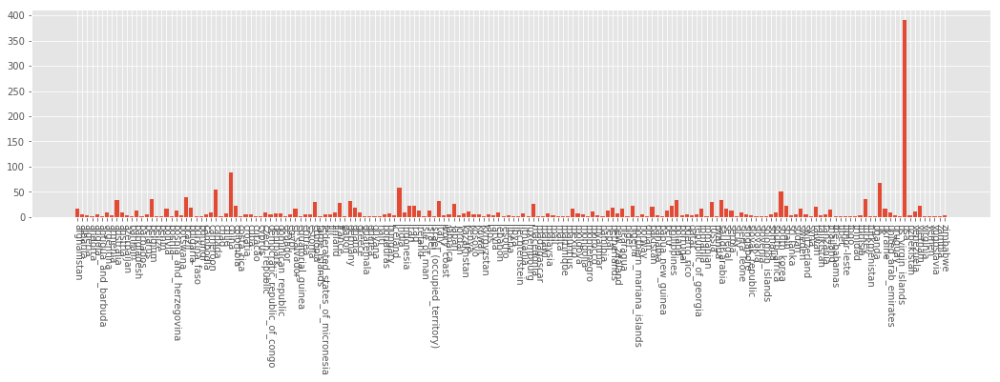

In [8]:
def get_labels(parent_dir,sub_dirs,file_ext='*.mp3'):
    labels = np.empty(0)
    for label, sub_dir in enumerate(sub_dirs):
        for fn in glob.glob(os.path.join(parent_dir, sub_dir, file_ext)):
            try:
                class_value = fn.split('fold')[1].split('-')[1]
                labels = np.append(labels, class_value)
            except:
                print("Error processing " + fn + " - skipping")
    return labels

labels = []
counts = []
for _, label, fnames in iter_label_files(parent_dir):
    labels.append(label)
    counts.append(len(fnames))

plt.figure(figsize=(18,4))
plt.bar(np.arange(len(labels)), counts, align='center')
plt.xticks(np.arange(len(labels)), labels)
plt.xticks(rotation=-90)
plt.show()

In [12]:
cap = 20
top_indices_count = [i_count for i_count in sorted(enumerate(counts), key=lambda x:x[1], reverse=True)]
most_freq_egs = [labels[i] for (i, count) in top_indices_count if count >= cap]
most_freq_egs

['usa',
 'china',
 'uk',
 'india',
 'canada',
 'south_korea',
 'brazil',
 'belgium',
 'turkey',
 'poland',
 'australia',
 'saudi_arabia',
 'germany',
 'italy',
 'ethiopia',
 'russia',
 'france',
 'japan',
 'macedonia',
 'philippines',
 'colombia',
 'iran',
 'iraq',
 'nigeria',
 'spain',
 'vietnam',
 'pakistan',
 'taiwan']

- Majority of examples are `usa, china, uk, india, canada, south_korea`.
- Training on just usa may give only good performance on that class, so we shall train across the same number of examples for each class.
- So we use 28 classes with at least 20 examples, and use 20 examples for each class.

# Save features

In [11]:
import random

def parse_audio_files(fnames):
    """
    Each example is a vector with 195 attribute features
    """
    features, labels = np.empty((0,195)), np.empty(0)
    try:
        for fn in fnames:            
            print(fn)
            mfccs, mfcc_ds, mfcc_d_ds, chroma, mel, contrast, tonnetz = extract_feature(fn)
            ext_features = np.hstack([mfccs, mfcc_ds, mfcc_d_ds, chroma, mel, contrast, tonnetz])
            features = np.vstack([features, ext_features]) # x_i
            label_txt = fn.split('/')[-2]  # y_i
            label_int = le.transform([label_txt])
            labels = np.append(labels, label_int)
    except:
        print("Err")
    return np.array(features), np.array(labels, dtype = np.int)

def get_subset_fnames(cap=20):
    fnames = glob.glob('**/*.mp3', recursive=True)
    subset_fnames = []
    for root, label, fnames in iter_label_files(parent_dir):
        if label in most_freq_egs:
            for fn in fnames[:cap]:
                subset_fnames.append(os.path.join(root, fn))
    random.seed(1)
    random.shuffle(subset_fnames)
    return subset_fnames

def save_folds(save_dir, num_folds=10, stop=2):
    fnames = get_subset_fnames()
    egs_per_fold = len(fnames) // num_folds
    curr = 0
    for k in range(num_folds):
        fold_name = 'fold_' + str(k)
        print("\nSaving " + fold_name)
        start_i = k * egs_per_fold
        end_i = (k + 1) * egs_per_fold
        fnames_fold = fnames[start_i: end_i]
        features, labels = parse_audio_files(fnames_fold)
        
        print(f"Features of {fold_name} = {features.shape}")
        print(f"Labels of {fold_name} = {labels.shape}")
        
        feature_file = os.path.join(save_dir, fold_name + '_x.npy')
        labels_file = os.path.join(save_dir, fold_name + '_y.npy')
        np.save(feature_file, features)
        np.save(labels_file, labels)
        print("Saved " + feature_file)
        print("Saved " + labels_file)
        return
        

def assure_path_exists(path):
    mydir = os.path.join(os.getcwd(), path)
    if not os.path.exists(mydir):
        os.makedirs(mydir)
        
        
save_dir = "npy"
assure_path_exists(save_dir)
save_folds(save_dir)


Saving fold_0
data/speech-accent-archive/recordings/vietnam/vietnamese21.mp3
Features : 610304, sampled at 22050 hz
data/speech-accent-archive/recordings/canada/english299.mp3
Features : 624400, sampled at 22050 hz
data/speech-accent-archive/recordings/saudi_arabia/arabic39.mp3
Features : 719671, sampled at 22050 hz
data/speech-accent-archive/recordings/turkey/turkish16.mp3
Features : 545738, sampled at 22050 hz
data/speech-accent-archive/recordings/south_korea/korean26.mp3
Features : 524595, sampled at 22050 hz
data/speech-accent-archive/recordings/saudi_arabia/arabic36.mp3
Features : 848913, sampled at 22050 hz
data/speech-accent-archive/recordings/brazil/portuguese3.mp3
Features : 1080361, sampled at 22050 hz
data/speech-accent-archive/recordings/taiwan/taiwanese3.mp3
Features : 1004378, sampled at 22050 hz
data/speech-accent-archive/recordings/ethiopia/amharic3.mp3
Features : 526920, sampled at 22050 hz
data/speech-accent-archive/recordings/turkey/turkish26.mp3
Features : 623482, 